# Singer vs Rapper Classification

# Import Library

In [ ]:
# Import library yang dibutuhkan
import os  # Untuk manajemen file dan direktori
import numpy as np  # Untuk operasi numerik
import pandas as pd  # Untuk manipulasi data
import tensorflow as tf  # Untuk membangun dan melatih model deep learning
print(f'TensorFlow version: {tf.__version__}')  # Cek versi TensorFlow

# Library untuk membangun model neural network
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten
from tensorflow.keras.optimizers import Adam
# Import ModelCheckpoint here
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.losses import BinaryCrossentropy
from sklearn.metrics import classification_report  # Untuk evaluasi model

# Library untuk pemrosesan data dan evaluasi
from sklearn import metrics
from sklearn.model_selection import train_test_split

# Library untuk pemrosesan audio
import librosa
import librosa.display
import soundfile as sf

# Library untuk visualisasi
import seaborn as sns
import matplotlib.pyplot as plt
import IPython.display as ipd  # Untuk menampilkan audio dalam notebook

# Alat bantu tambahan
from itertools import cycle  # Untuk mengatur siklus warna dalam grafik

# Mengatur tema visualisasi seaborn
sns.set_theme(style='white', palette=None)
color_pal = plt.rcParams["axes.prop_cycle"].by_key()['color']
color_cycle = cycle(plt.rcParams["axes.prop_cycle"].by_key()['color'])

TensorFlow version: 2.18.0


# Mengimpor dan Memuat File Audio

 Menghubungkan Google Colab dengan Google Drive

In [ ]:
# Menghubungkan Google Colab dengan Google Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Mengimpor File Audio dari Google Drive

In [ ]:
import os

# Tentukan path ke folder audio di dalam Google Drive
singer_path = "/content/drive/MyDrive/audio_classification/Artists/Singer"
rapper_path = "/content/drive/MyDrive/audio_classification/Artists/Rapper"

# Mengimpor file audio dari folder Singer
s = []
for root, dirs, files in os.walk(singer_path, topdown=False):
    for name in files:
        if name != '.DS_Store':  # Hindari file sistem yang tidak relevan
            abs_path = os.path.join(root, name)
            s.append(abs_path)

# Mengimpor file audio dari folder Rapper
r = []
for root, dirs, files in os.walk(rapper_path, topdown=False):
    for name in files:
        if name != '.DS_Store':
            abs_path = os.path.join(root, name)
            r.append(abs_path)

s  # Menampilkan daftar file audio di folder Singer

['/content/drive/MyDrive/audio_classification/Artists/Singer/Justin-Bieber-2-Much-(TrendyBeatz.com).mp3',
 '/content/drive/MyDrive/audio_classification/Artists/Singer/Justin-Bieber-All-Around-Me-(TrendyBeatz.com).mp3',
 '/content/drive/MyDrive/audio_classification/Artists/Singer/Justin-Bieber-Afraid-To-Say-(TrendyBeatz.com).mp3',
 '/content/drive/MyDrive/audio_classification/Artists/Singer/Justin-Bieber-Anyone-(TrendyBeatz.com).mp3',
 '/content/drive/MyDrive/audio_classification/Artists/Singer/Justin-Bieber-As-I-Am-Ft-Khalid-(TrendyBeatz.com).mp3',
 '/content/drive/MyDrive/audio_classification/Artists/Singer/Justin-Bieber-Available-(TrendyBeatz.com).mp3',
 '/content/drive/MyDrive/audio_classification/Artists/Singer/Justin-Bieber-Deserve-You-(TrendyBeatz.com).mp3',
 '/content/drive/MyDrive/audio_classification/Artists/Singer/Justin-Bieber-At-Least-For-Now-(TrendyBeatz.com).mp3',
 '/content/drive/MyDrive/audio_classification/Artists/Singer/Justin-Bieber-Ft-Burna-Boy-Loved-By-You-(TrendyB

Visualisasi Gelombang Suara (Waveform)

Singer

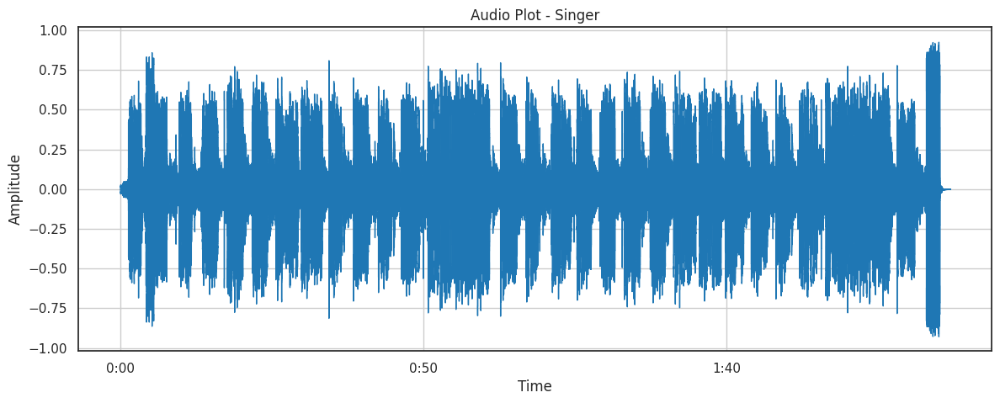

In [ ]:
import librosa.display

# Memuat file audio dari daftar Singer
x, sr = librosa.load(s[1])

# Menampilkan bentuk gelombang audio
plt.figure(figsize=(14, 5))
plt.grid()
librosa.display.waveshow(x, sr=sr, color=color_pal[0])
plt.title("Audio Plot - Singer")
plt.ylabel("Amplitude")

# Menampilkan audio player agar bisa didengarkan
display(ipd.Audio(x, rate=sr))


Rapper

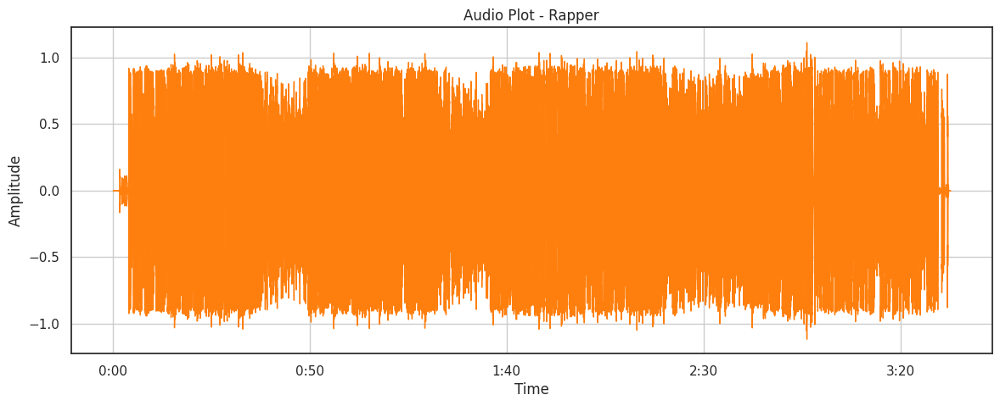

In [ ]:
# Memuat file audio dari daftar Rapper
x, sr = librosa.load(r[1])

# Menampilkan bentuk gelombang audio
plt.figure(figsize=(14, 5))
plt.grid()
librosa.display.waveshow(x, sr=sr, color=color_pal[1])
plt.title("Audio Plot - Rapper")
plt.ylabel("Amplitude")

# Menampilkan audio player agar bisa didengarkan
display(ipd.Audio(x, rate=sr))

# Ekstraksi Vokal dari Lagu Menggunakan Spleeter

In [ ]:
### 📌 Fungsi untuk Mengekstrak Vokal dari Banyak File Audio Menggunakan Spleeter
# Fungsi ini menjalankan Spleeter pada setiap file audio dalam daftar (input_list)
# dan menyimpan hasil ekstraksi vokalnya di folder output_dir.

# def extract_vocals(input_list, output_dir):
#     for i in input_list:
#         command = 'spleeter separate ' + i + ' -o ' + output_dir  # Perintah untuk menjalankan Spleeter
#         os.system(command)  # Menjalankan perintah di terminal

# # Membuat folder untuk menyimpan vokal dari file Singer
# output_dir = '/singer-vs-rapper/Vocals/Singer'
# os.makedirs(output_dir, exist_ok=True)
# extract_vocals(s, output_dir)  # Menjalankan ekstraksi vokal untuk Singer

# # Membuat folder untuk menyimpan vokal dari file Rapper
# output_dir = '/singer-vs-rapper/Vocals/Rapper'
# os.makedirs(output_dir, exist_ok=True)
# extract_vocals(r, output_dir)  # Menjalankan ekstraksi vokal untuk Rapper


# Mengimpor Vokal untuk Eksplorasi Data (EDA)

In [ ]:
vocals = []  # Menyimpan path file vokal
target = []  # Menyimpan label (Singer/Rapper)

# Memuat file vokal dari folder Singer
for root, dirs, files in os.walk("/content/drive/MyDrive/audio_classification/Vocals/Singer", topdown=False):
    for name in files:
        if name != '.DS_Store' and name != 'accompaniment.wav':  # Hindari file sistem & instrumen
            abs_path = os.path.join(root, name)
            vocals.append(abs_path)
            target.append('Singer')

# Memuat file vokal dari folder Rapper
for root, dirs, files in os.walk("/content/drive/MyDrive/audio_classification/Vocals/Rapper", topdown=False):
    for name in files:
        if name != '.DS_Store' and name != 'accompaniment.wav':
            abs_path = os.path.join(root, name)
            vocals.append(abs_path)
            target.append('Rapper')

# Membuat DataFrame untuk menyimpan informasi file vokal
df = pd.DataFrame({'Vocals': vocals, 'Target': target})
df  # Menampilkan DataFrame


,Vocals,Target
0,/content/drive/MyDrive/audio_classification/Vo...,Singer
1,/content/drive/MyDrive/audio_classification/Vo...,Singer
2,/content/drive/MyDrive/audio_classification/Vo...,Singer
3,/content/drive/MyDrive/audio_classification/Vo...,Singer
4,/content/drive/MyDrive/audio_classification/Vo...,Singer
5,/content/drive/MyDrive/audio_classification/Vo...,Rapper
6,/content/drive/MyDrive/audio_classification/Vo...,Rapper
7,/content/drive/MyDrive/audio_classification/Vo...,Rapper
8,/content/drive/MyDrive/audio_classification/Vo...,Rapper
9,/content/drive/MyDrive/audio_classification/Vo...,Rapper


visualisasi distribusi data berdasarkan kategori "Target" (Singer atau Rapper)

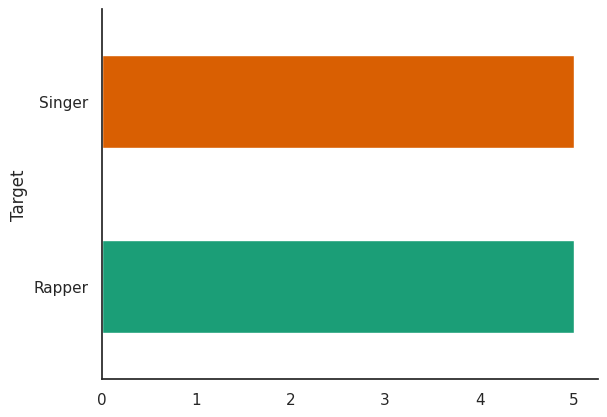

In [ ]:
from matplotlib import pyplot as plt
import seaborn as sns
df.groupby('Target').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

# Memvisualisasikan Gelombang Suara Vokal

Text(109.74999999999999, 0.5, 'Amplitude')

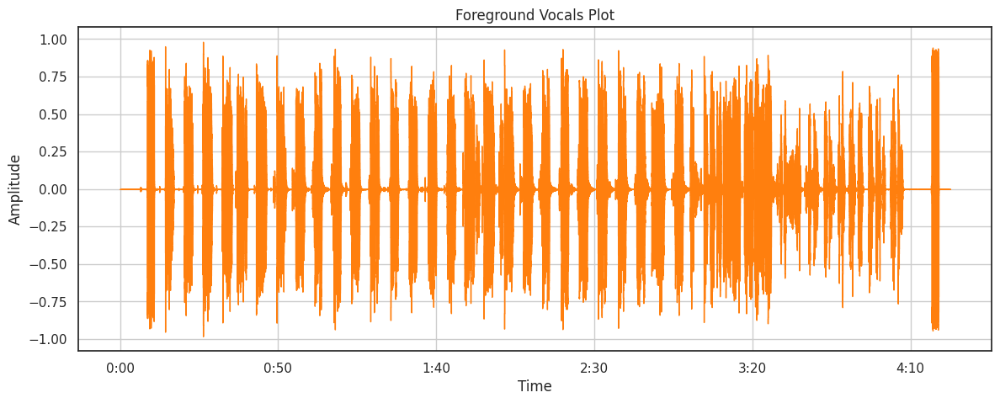

In [ ]:
plt.figure(figsize=(14, 5))  # Atur ukuran plot
plt.grid()  # Tambahkan grid agar lebih mudah dibaca

# Memuat file vokal pertama dalam DataFrame df
x, sr = librosa.load(df.Vocals[0])

# Menampilkan bentuk gelombang suara
librosa.display.waveshow(x, sr=sr, color=color_pal[1])
plt.title("Foreground Vocals Plot")  # Judul plot
plt.ylabel("Amplitude")  # Label sumbu Y

In [ ]:
# Memutar audio
ipd.Audio(x, rate=sr)

# Menghapus bagian audio yang sunyi (silence)

In [ ]:
nonMuteSections = librosa.effects.split(x, top_db=20)
nonMuteSections

array([[ 186368,  238592],
       [ 313856,  356352],
       [ 357888,  372224],
       [ 444928,  505856],
       [ 574464,  643072],
       [ 708608,  762880],
       [ 763392,  781312],
       [ 804864,  806400],
       [ 813568,  835584],
       [ 836096,  862720],
       [ 864256,  868864],
       [ 869376,  883712],
       [ 884736,  887296],
       [ 947712,  990208],
       [ 991232, 1020928],
       [1075200, 1079808],
       [1090560, 1102848],
       [1103360, 1155584],
       [1207296, 1213952],
       [1222656, 1252864],
       [1253376, 1286144],
       [1339904, 1346560],
       [1352192, 1406976],
       [1472000, 1479168],
       [1484288, 1502720],
       [1503744, 1517056],
       [1518080, 1539584],
       [1607680, 1610752],
       [1611264, 1671680],
       [1743360, 1805312],
       [1884672, 1939968],
       [2013696, 2030080],
       [2030592, 2071040],
       [2145792, 2172928],
       [2174464, 2205696],
       [2278912, 2311680],
       [2312192, 2338304],
 

In [ ]:
wav = np.concatenate([x[start:end] for start, end in nonMuteSections])

menampilkan bentuk gelombang (waveform) dari audio

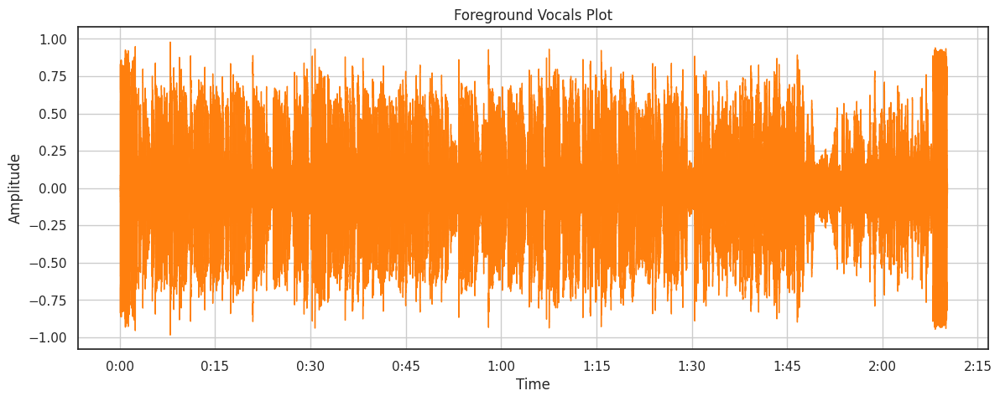

In [ ]:
plt.figure(figsize=(14, 5))  # Membuat figure dengan ukuran 14x5 inci
plt.grid()  # Menambahkan grid untuk memudahkan analisis visual

librosa.display.waveshow(wav, sr=sr, color=color_pal[1])
# Menampilkan bentuk gelombang audio menggunakan warna dari color_pal

plt.title("Foreground Vocals Plot")  # Judul plot
a = plt.ylabel("Amplitude")  # Label sumbu Y menunjukkan amplitudo audio

ipd.Audio(wav, rate=sr)  # Memutar audio setelah pemrosesan


# Ekstraksi Sampel Audio (~6 detik)

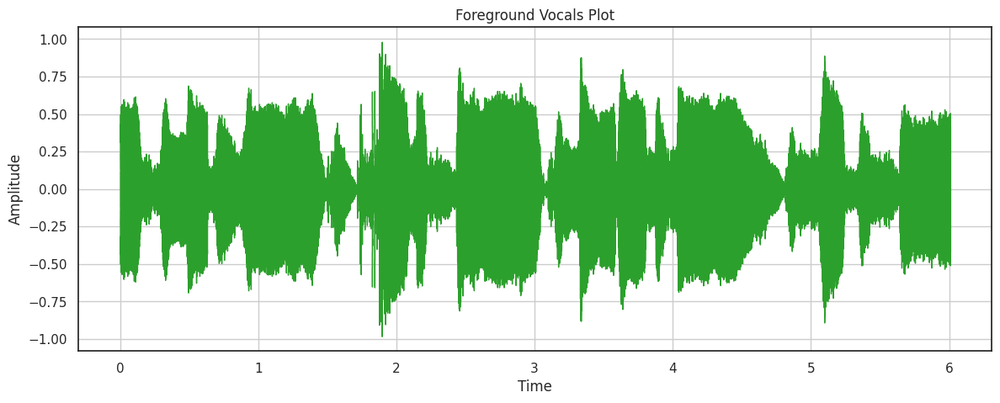

In [ ]:
a = 132500  # Menentukan jumlah sampel untuk sekitar 6 detik
interval_1 = wav[a:a*2]  # Mengambil bagian audio dari posisi a sampai 2*a (sekitar 6 detik)

plt.figure(figsize=(14, 5))  # Membuat figure dengan ukuran 14x5 inci
plt.grid()  # Menampilkan grid

librosa.display.waveshow(interval_1, sr=sr, color=color_pal[2])
# Menampilkan bentuk gelombang (waveform) dari audio yang dipotong

plt.title("Foreground Vocals Plot")  # Menambahkan judul
a = plt.ylabel("Amplitude")  # Menampilkan label sumbu Y

ipd.Audio(interval_1, rate=sr)  # Memutar audio hasil ekstraksi

# Menghapus Silence & Menyimpan Sampel 5 Detik

In [ ]:
dir_path = '/content/drive/MyDrive/audio_classification/Samples'
os.makedirs(dir_path, exist_ok=True)

In [ ]:
# menentukan panjang interval (132500 sampel ≈ 6 detik jika sr=22050 Hz)
interval_length = 132500

# Fungsi untuk menghapus bagian senyap & membagi audio menjadi potongan kecil
def foreground_process(input_list, final_directory, interval_length=132500, number_of_intervals=6):
    count = 1
    os.makedirs(final_directory, exist_ok=True)

    for i in input_list:
        x, sr = librosa.load(i)  # Memuat file audio

        # Menghapus bagian senyap dari audio
        nonMuteSections = librosa.effects.split(x, top_db=20)
        wav = np.concatenate([x[start:end] for start, end in nonMuteSections])

        # Membagi audio menjadi beberapa potongan kecil (5-6 detik per potongan)
        for j in range(number_of_intervals):
            start = (j+1) * interval_length  # Indented this line
            end = (j+2) * interval_length  # Indented this line

            # Cek apakah masih ada cukup audio untuk diambil
            if start < len(wav):  # Indented this line and the following block
                interval = wav[start:end]
                sf.write(f"{final_directory}/{count}.wav", interval, sr, 'PCM_24')
                count += 1

# Menyimpan sampel audio penyanyi
final_directory = '/content/drive/MyDrive/audio_classification/Samples/Singer'
foreground_process(df.Vocals[df.Target == 'Singer'], final_directory)

# Menyimpan sampel audio rapper
final_directory = '/content/drive/MyDrive/audio_classification/Samples/Rapper'
foreground_process(df.Vocals[df.Target == 'Rapper'], final_directory)

# Membuat Dataframe Sampel Audio untuk Klasifikasi

In [ ]:
# Mengumpulkan path file audio dari folder "Samples" dan memberi label

import os
import pandas as pd

vocals = []
target = []

# Loop untuk mengumpulkan file dari folder Singer dan Rapper
for category in ["Singer", "Rapper"]:
    folder_path = f"/content/drive/MyDrive/audio_classification/Samples/{category}"

    for root, dirs, files in os.walk(folder_path, topdown=False):
        for name in files:
            if name not in ['.DS_Store', 'accompaniment.wav']:
                abs_path = os.path.join(root, name)
                vocals.append(abs_path)
                target.append(category)

# Membuat dataframe
df_samples = pd.DataFrame({'Vocals': vocals, 'Target': target})
df_samples


,Vocals,Target
0,/content/drive/MyDrive/audio_classification/Sa...,Singer
1,/content/drive/MyDrive/audio_classification/Sa...,Singer
2,/content/drive/MyDrive/audio_classification/Sa...,Singer
3,/content/drive/MyDrive/audio_classification/Sa...,Singer
4,/content/drive/MyDrive/audio_classification/Sa...,Singer
...,...,...
295,/content/drive/MyDrive/audio_classification/Sa...,Rapper
296,/content/drive/MyDrive/audio_classification/Sa...,Rapper
297,/content/drive/MyDrive/audio_classification/Sa...,Rapper
298,/content/drive/MyDrive/audio_classification/Sa...,Rapper


mengecek keseimbangan data

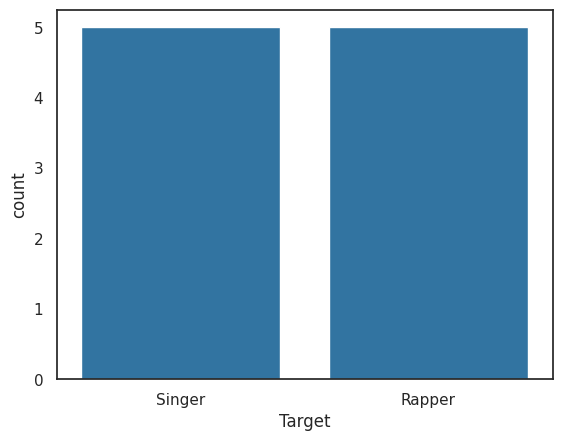

In [ ]:
sns.countplot(data=df, x="Target")  # Menggunakan x untuk orientasi vertikal
plt.show()

#  Mengekstrak fitur MFCC (Mel Frequency Cepstral Coefficients)

In [ ]:
mfcc = librosa.feature.mfcc(y=wav, sr=sr)
mfcc

array([[-418.61523  , -339.92804  , -276.30194  , ..., -281.39957  ,
        -323.67987  , -392.2824   ],
       [  87.8971   ,  151.81143  ,  182.835    , ...,  150.28885  ,
         136.54895  ,   98.83924  ],
       [  56.93334  ,   76.74265  ,   85.129295 , ...,   24.444248 ,
          18.163853 ,   32.42601  ],
       ...,
       [  -5.011809 ,    1.9260026,    6.7809153, ...,   -8.35857  ,
           0.6319104,    7.828662 ],
       [  -5.0314107,   -7.8823357,  -10.044443 , ...,   -6.6296864,
           1.7613649,   11.4788885],
       [  -4.735046 ,   -5.3933115,    3.0787134, ...,   -5.778616 ,
          -1.2796319,    2.3926091]], dtype=float32)

In [ ]:
print(mfcc.shape)

(20, 5608)


In [ ]:
def feature_extractor(file):
    audio, sr = librosa.load(file)  # Membaca file audio
    mfccs_features = librosa.feature.mfcc(y=audio, sr=sr)  # Mengekstrak MFCC
    mfccs_scaled_features = np.mean(mfccs_features.T, axis=0)  # Merata-ratakan MFCC

    return mfccs_scaled_features  # Mengembalikan hasil


In [ ]:
def batch_extractor(input_list):
    extracted_features = []  # Menyimpan hasil ekstraksi fitur
    for i in input_list:  # Looping setiap file audio
        extracted_features.append(feature_extractor(i))  # Ekstrak MFCC dan simpan

    return extracted_features  # Mengembalikan daftar fitur

# Ekstrak fitur dari semua file dalam df_samples
extracted_features = batch_extractor(df_samples.Vocals)

KeyboardInterrupt: 

In [ ]:
df_samples['features'] = extracted_features
df_samples

In [ ]:
# Mengacak urutan dataset agar distribusi lebih merata
df_samples = df_samples.sample(frac=1).reset_index(drop=True)
df_samples

In [ ]:
# Menampilkan label unik dalam dataset
print(df_samples['Target'].unique())

In [ ]:
df_samples['Target'].replace({'Singer': 1, 'Rapper': 0}, inplace=True)

X = np.array(df_samples['features'].tolist())
y = np.array(df_samples['Target'].tolist())
y

In [ ]:
print(X.shape)
print(y.shape)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.20)
print(X_train.shape)
print(y_train.shape)

# Model Building

In [ ]:
model = Sequential()

#First layer stack
model.add(Dense(100, input_shape=(20,)))
model.add(Activation('relu'))
model.add(Dropout(0.5))


#Second layer stack
model.add(Dense(200))
model.add(Activation('relu'))
model.add(Dropout(0.5))


#Third layer stack
model.add(Dense(200))
model.add(Activation('relu'))
model.add(Dropout(0.5))


#Final Layer
model.add(Dense(1))
model.add(Activation("sigmoid"))

model.summary()

In [ ]:
# Save the best model
saved_callbacks = ModelCheckpoint('./content/saved_models/bestmodel.h5',
                                  save_weights_only=False,
                                  monitor='loss',
                                  save_best_only=True)

model.compile(optimizer = Adam(),
             loss = BinaryCrossentropy(),
              metrics = ['accuracy',])

history = model.fit(X_train, y_train, epochs=100, batch_size=32,
                   callbacks=[saved_callbacks]
    )

# Evaluasi Model

In [ ]:
plt.subplot(2 ,1, 1)
a = plt.plot(history.history['loss'])
plt.ylabel('loss')
plt.xlabel('epoch')


plt.subplot(2, 1 ,2)
b = plt.plot(history.history['accuracy'],color="orange")
plt.ylabel('accuracy')
plt.xlabel('epoch')

plt.tight_layout()
plt.show()

In [ ]:
y_preds = model.predict(X_test)
y_preds = (y_preds>0.5).flatten()
y_preds = y_preds.astype('int')
y_preds

In [ ]:
print(classification_report(y_preds, y_test))

In [ ]:
# Fungsi untuk memuat file audio dan mengekstrak fitur MFCC
def load_and_extract_features(file_path):
    if os.path.exists(file_path):
        print("File ditemukan:", file_path)
        audio, sr = librosa.load(file_path, sr=16000)
        mfccs_features = librosa.feature.mfcc(y=audio, sr=sr)
        mfccs_scaled_features = np.mean(mfccs_features.T, axis=0)
        return mfccs_scaled_features
    else:
        print("File tidak ditemukan!")
        return None

# Path ke file audio yang akan diuji
file_path = os.path.abspath("/content/drive/MyDrive/audio_classification/Samples/Rapper/1.wav")

# Memuat dan mengekstrak fitur dari file audio
features = load_and_extract_features(file_path)

if features is not None:
    # Mengubah fitur menjadi array 2D untuk prediksi
    features = np.array([features])

    # Melakukan prediksi menggunakan model yang sudah dilatih
    prediction = model.predict(features)
    prediction = (prediction > 0.5).astype('int')

    # Menampilkan hasil prediksi
    if prediction == 1:
        print("Prediksi: Singer")
    else:
        print("Prediksi: Rapper")

File ditemukan: /content/drive/MyDrive/audio_classification/Samples/Rapper/1.wav
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
Prediksi: Rapper
